### Libraries



In [ ]:
import numpy as np
import cv2 as cv
import scipy.signal as sig
import scipy.ndimage as nd
import matplotlib.pyplot as plt
from matplotlib.patches import ConnectionPatch
import os

### Reading images

In [ ]:
path1 = "/content/Q3_1.jpg"
path2 = "/content/Q3_2.jpg"
im1 = cv.imread(path1)
im2 = cv.imread(path2)

### Some initial funtions

In [ ]:
def save_fig(name):
    if not os.path.exists("Results/"):
        os.mkdir("Results/")
    plt.savefig("Results/" + name, bbox_inches='tight')
def plot_array(name, array, size=(10, 10)):
    if size is not None:
        plt.figure(figsize=size)
    plt.imshow(array, cmap='gray')
    plt.axis('off')
    if name is not None:
        save_fig(name)
def get_image(path):
    return cv.cvtColor(cv.imread(path), cv.COLOR_BGR2RGB)
def plot_double_arrays(name, array1, array2, size=(40, 40)):
    plt.figure(figsize=size)
    plt.subplot(1, 2, 1)
    plot_array(None, array1, size=None)
    plt.subplot(1, 2, 2)
    plot_array(None, array2, size=None)
    save_fig(name)

def crop_zero_parts(image):
    x, y, _ = np.nonzero(image)

    x_max = np.max(x)
    x_min = np.min(x)
    y_max = np.max(y)
    y_min = np.min(y)

    return image[x_min:x_max, y_min:y_max, :]

### Finding $I_x$ and $I_y$ and then Finding $I_x^2$, $I_y^2$ and $I_x I_y$

In [ ]:

def get_grad(image):
    """"
    I used sobel filters to compute the derivations of the image
    """
    Gx = np.array([[1, 2, 1], [0, 0, 0], [-1, -2, -1]])
    Gy = Gx.transpose()
    im_red = image[:,:,0]
    im_green = image[:,:,1]
    im_blue = image[:,:,2]
    Ix1 = sig.convolve2d(im_red, Gx, mode='valid')
    Ix2 = sig.convolve2d(im_green, Gx, mode='valid')
    Ix3 = sig.convolve2d(im_blue, Gx, mode='valid')

    Iy1 = sig.convolve2d(im_red, Gy, mode='valid')
    Iy2 = sig.convolve2d(im_green, Gy, mode='valid')
    Iy3 = sig.convolve2d(im_blue, Gy, mode='valid')

    Ix =  np.maximum(Ix1, np.maximum(Ix2,Ix3))
    Iy =  np.maximum(Iy1, np.maximum(Iy2,Iy3))

    Ix2 = Ix * Ix
    Iy2 = Iy * Iy
    Ixy = Ix * Iy

    return Ix2, Iy2, Ixy



In [ ]:
Ix1, Iy1, Ixy1 = get_grad(im1)
Ix2, Iy2, Ixy2 = get_grad(im2)

Text(0.5, 1.0, '$Ix_2 * Iy_2$')

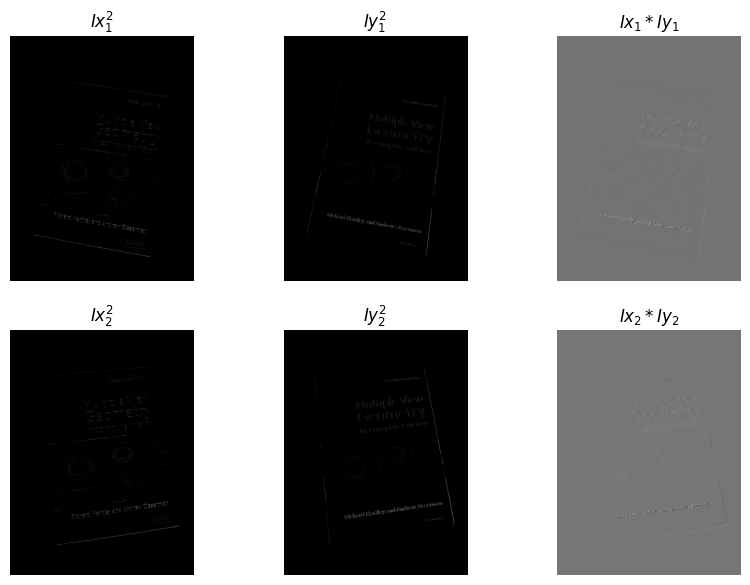

In [ ]:
# create figure
fig = plt.figure(figsize=(10, 7))

# setting values to rows and column variables
rows = 2
columns = 3

fig.add_subplot(rows, columns, 1)
plt.imshow(Ix1, cmap='gray')
plt.axis('off')
plt.title("$Ix_1^2$")
fig.add_subplot(rows, columns, 2)
plt.imshow(Iy1, cmap='gray')
plt.axis('off')
plt.title("$Iy_1^2$")
fig.add_subplot(rows, columns, 3)
plt.imshow(Ixy1, cmap='gray')
plt.axis('off')
plt.title("$Ix_1 * Iy_1$")

fig.add_subplot(rows, columns, 4)
plt.imshow(Ix2, cmap='gray')
plt.axis('off')
plt.title("$Ix_2^2$")
fig.add_subplot(rows, columns, 5)
plt.imshow(Iy2, cmap='gray')
plt.axis('off')
plt.title("$Iy_2^2$")
fig.add_subplot(rows, columns, 6)
plt.imshow(Ixy2, cmap='gray')
plt.axis('off')
plt.title("$Ix_2 * Iy_2$")

### Applying guassian filter

Parameter: $σ = 2$

In [ ]:
def applying_guassian_filter(Ix2,Iy2,Ixy, sigma):
    Sx2 = nd.gaussian_filter(Ix2, sigma=sigma)
    Sy2 = nd.gaussian_filter(Iy2, sigma=sigma)
    Sxy = nd.gaussian_filter(Ixy, sigma=sigma)
    return Sx2, Sy2, Sxy

In [ ]:
sigma = 2
Sx2_1, Sy2_1, Sxy_1 = applying_guassian_filter(Ix1, Iy1, Ixy1, sigma=sigma)
Sx2_2, Sy2_2, Sxy_2 = applying_guassian_filter(Ix2, Iy2, Ixy2, sigma=sigma)

### Finding determinat and trace

Parameter: $k=0.1$

k should be less than 0.25

In [ ]:
def compute_score(Sx2, Sy2, Sxy, k):
    det = Sx2*Sy2 - (Sxy**2)
    tr = Sx2 + Sy2
    score = det - k*(tr**2)
    return score,det,tr

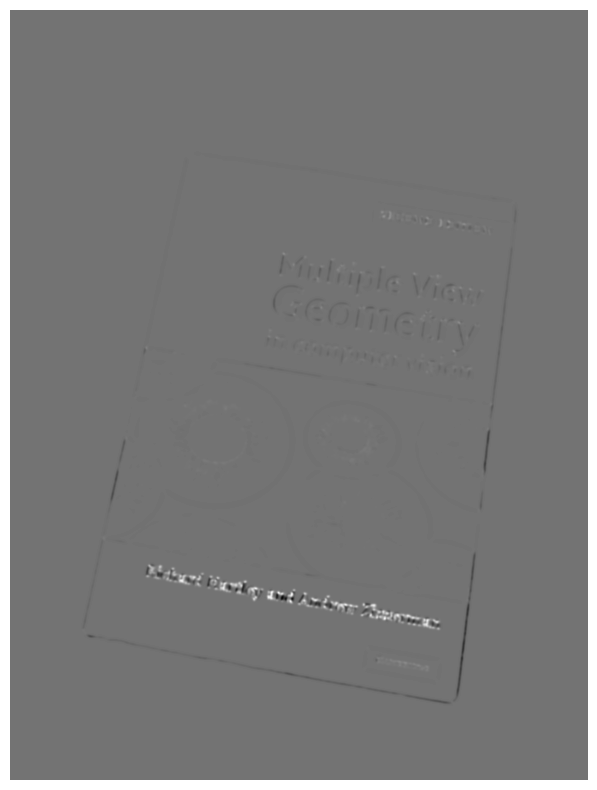

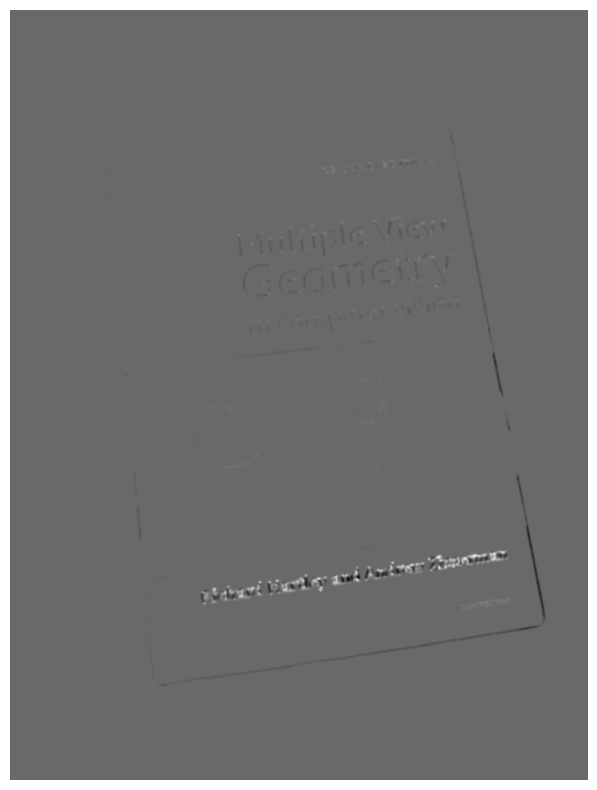

In [ ]:
k = 0.1
score_01,_,_ = compute_score(Sx2_1, Sy2_1, Sxy_1, k)
score_02,_,_ = compute_score(Sx2_2, Sy2_2, Sxy_2, k)
plot_array("res04_score.jpg", score_01)
plot_array("res05_score.jpg", score_02)


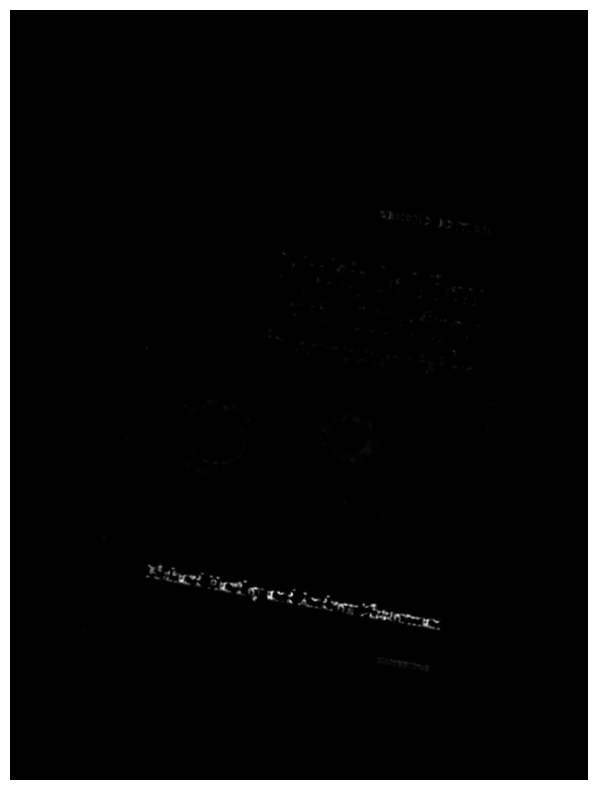

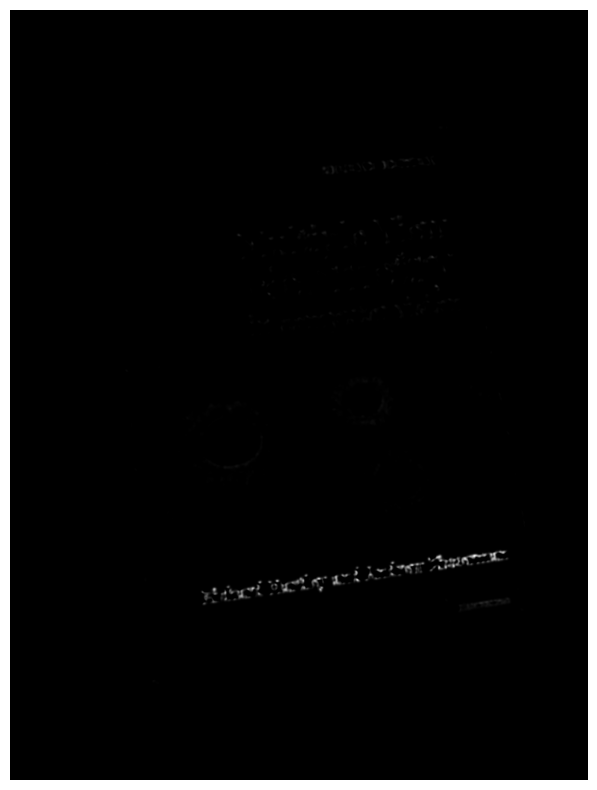

In [ ]:
threshold = 10000000
plot_array("res06_thresh.jpg", score_01 * (score_01 > threshold))
plot_array("res07_thresh.jpg", score_02 * (score_02 > threshold))

### Using non_maximum suppression and finding feacher vector

In [ ]:
def get_gray_image(path):
    im = cv.imread(path)
    gray_image = cv.cvtColor(im, cv.COLOR_BGR2GRAY)
    return gray_image

In [ ]:
def non_maximum_suppression(scores, tr, radius):
    lx, ly = scores.shape
    scores = scores * (scores > tr)
    new_scores = np.copy(scores)
    for x in range(lx):
        for y in range(ly):
            if new_scores[x, y] <= tr:
                new_scores[x, y] = 0
                continue

            new_scores = one_point_nms(new_scores, radius, x, y)
    return new_scores
def one_point_nms(scores, radius, x, y):
    lx, ly = scores.shape
    copy_scores = np.copy(scores)
    for dx in range(radius):
        if x + dx >= lx:
            break
        for dy in range(-radius, radius):
            if y + dy >= ly:
                break
            if (dy == 0 and dx == 0) or dx**2 + dy**2 >= radius**2 or y + dy < 0:
                continue
            if scores[x + dx, y + dy] <= scores[x, y]:
                copy_scores[x + dx, y + dy] = 0
            else:
                scores[x, y] = 0
                return scores
    return copy_scores
def get_feature_vector(gray_image, x, y, n):
    feature_vector = np.zeros((2*n+1)**2)
    lx, ly = gray_image.shape

    if x < n or y < n or x >= lx + n or y >= ly + n:
        feature_vector[0] = None
        return feature_vector
    i = 0
    for dx in range(-n, n + 1):
        for dy in range(-n, n + 1):
            feature_vector[i] = gray_image[x + dx, y + dy]
            i += 1
    return feature_vector


def get_nonzero_locs(array):
    locs_2d_list = np.nonzero(array)
    locs = []
    for i in range(locs_2d_list[0].shape[0]):
        x = locs_2d_list[0][i]
        y = locs_2d_list[1][i]
        locs.append([x, y])
    return locs

def get_int_points_features(int_points, gray_image, n):
    int_points = get_nonzero_locs(int_points)
    features_out = []
    int_points_out = []
    for i in range(len(int_points)):
        x = int_points[i][0]
        y = int_points[i][1]
        feature_vector = get_feature_vector(gray_image, x, y, n)
        if feature_vector[0] is not None:
            features_out.append(feature_vector)
            int_points_out.append([x, y])
    return features_out, int_points_out


def get_dist(feat1, feat2):
    return np.sqrt(np.sum((feat1 - feat2)**2))

def get_nearests(feature, features_list):
    d1 = get_dist(feature, features_list[0])
    d2 = get_dist(feature, features_list[1])
    if d1 < d2:
        p1 = 0
        p2 = 1
    else:
        p1 = 1
        p2 = 0
        tmp = d1
        d1 = d2
        d2 = tmp

    for i in range(2, len(features_list)):
        d = get_dist(feature, features_list[i])
        if d <= d1:
            d2 = d1
            p2 = p1
            p1 = i
            d1 = d
        elif d <= d2:
            d2 = d
            p2 = i
    return p1, d1, p2, d2

def check_d1_d2_tr(tr, features1, features2):
    dic = {}
    for i in range(len(features1)):
        p1, d1, p2, d2 = get_nearests(features1[i], features2)
        if d2/d1 > tr:
            dic[i] = p1
    return dic


def get_corresponding_points(dic1, dic2):
    points = []
    for p1 in dic1.keys():
        p2 = dic1[p1]
        if p2 in dic2.keys():
            if dic2[p2] == p1:
                points.append([p1, p2])
    return points


def plot_final_interest_points(path, points, num, inp, name, size=(40, 40)):
    plt.figure(figsize=size)
    plt.imshow(get_image(path))
    for i in range(len(points)):
        xy = inp[points[i][num]]
        plt.plot(xy[1], xy[0], 'ro', markersize=15)
        plt.axis("off")
    save_fig(name)

#### non_maximum suppression

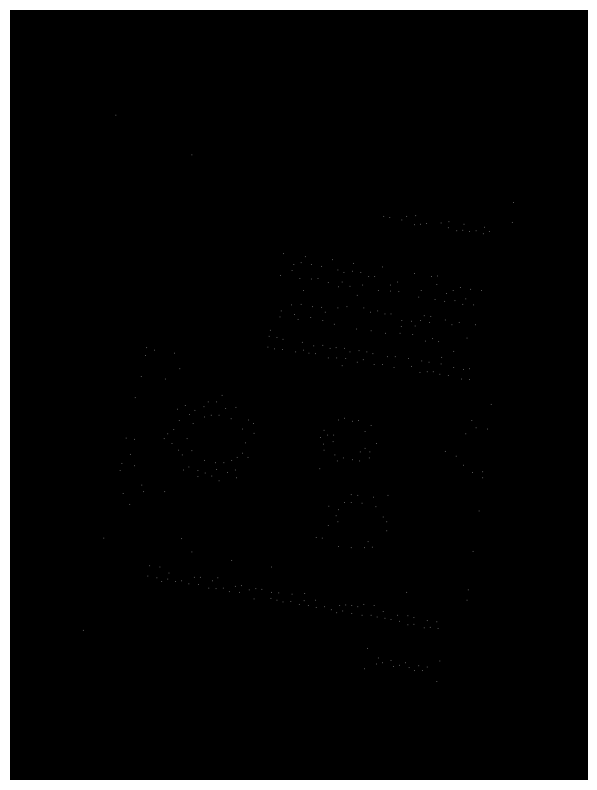

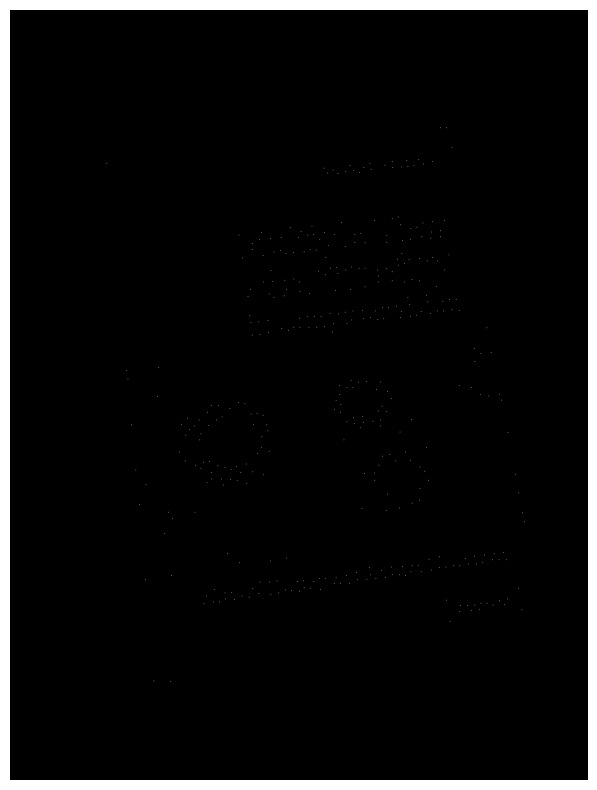

In [ ]:
radius = 10
int_points1 = non_maximum_suppression(score_01, threshold, radius)
int_points2 = non_maximum_suppression(score_02, threshold, radius)
plot_array("res06_harris.jpg", int_points1 != 0)
plot_array("res07_harris.jpg", int_points2 != 0)

### Finding feacher vector

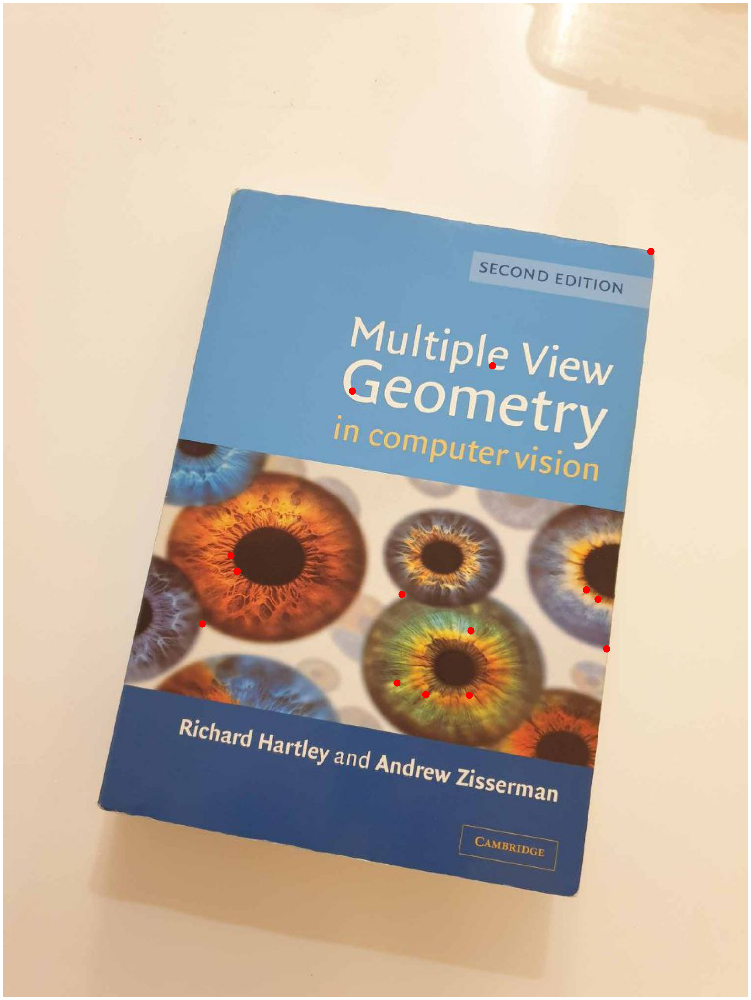

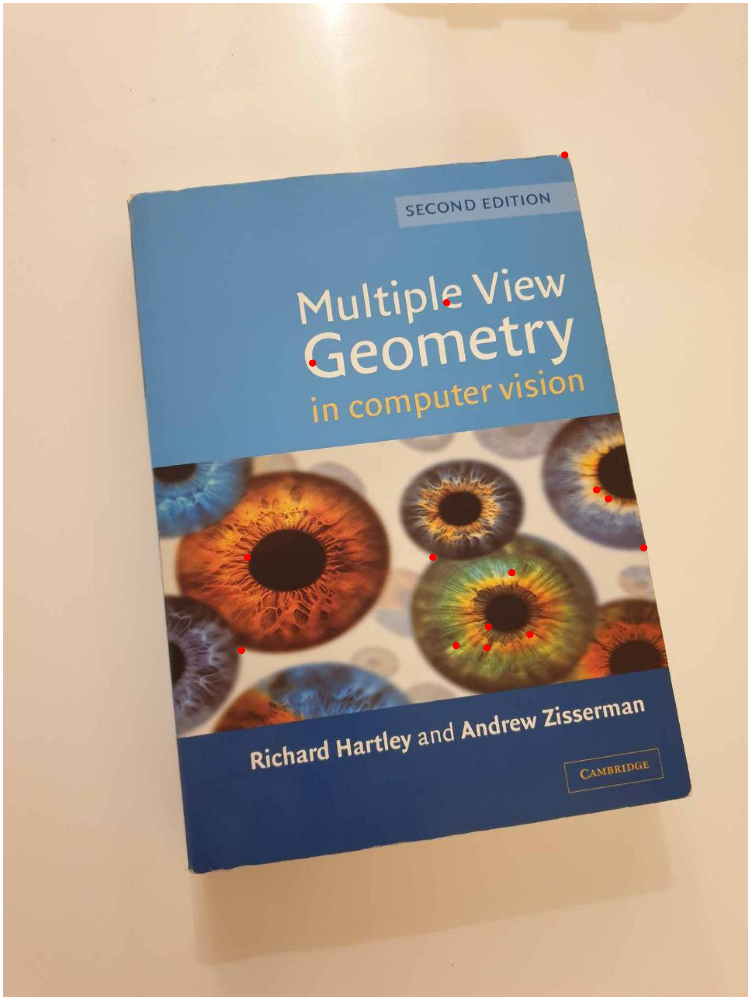

In [ ]:
n = 20
features1, int_points1 = get_int_points_features(int_points1, get_gray_image(path1), n)
features2, int_points2 = get_int_points_features(int_points2, get_gray_image(path2), n)

d2_d1_ratio = 1.15
dic1 = check_d1_d2_tr(d2_d1_ratio, features1, features2)
dic2 = check_d1_d2_tr(d2_d1_ratio, features2, features1)

points = get_corresponding_points(dic1, dic2)

plot_final_interest_points(path1, points, 0, int_points1, "res08_corres.jpg")
plot_final_interest_points(path2, points, 1, int_points2, "res09_corres.jpg")

### Matching points

In [ ]:

def plot_corresponding_points(path1, path2, points, inp1, inp2, name, num_points=20, size=(40, 40)):
    fig = plt.figure(figsize=size)
    ax1 = fig.add_subplot(121)
    ax2 = fig.add_subplot(122)
    ax1.imshow(get_image(path1))
    ax2.imshow(get_image(path2))
    cm = plt.get_cmap('gist_rainbow')
    for i in range(min(len(points), num_points)):
        xy1 = inp1[points[i][0]].copy()
        xy2 = inp2[points[i][1]].copy()

        tmp = xy1[0]
        xy1[0] = xy1[1]
        xy1[1] = tmp
        tmp = xy2[0]
        xy2[0] = xy2[1]
        xy2[1] = tmp

        color = cm(i / min(len(points), num_points))
        con = ConnectionPatch(xyA=xy1, xyB=xy2, coordsA="data", coordsB="data",
                              axesA=ax1, axesB=ax2, color=color, linewidth=3)
        ax2.add_artist(con)

        ax1.plot(xy1[0], xy1[1], 'ro', markersize=15, color=color)
        ax2.plot(xy2[0], xy2[1], 'ro', markersize=15, color=color)

    ax1.axis("off")
    ax2.axis("off")

    save_fig(name)

<ipython-input-16-194bb50cc6ce>:24: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  ax1.plot(xy1[0], xy1[1], 'ro', markersize=15, color=color)
<ipython-input-16-194bb50cc6ce>:25: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  ax2.plot(xy2[0], xy2[1], 'ro', markersize=15, color=color)


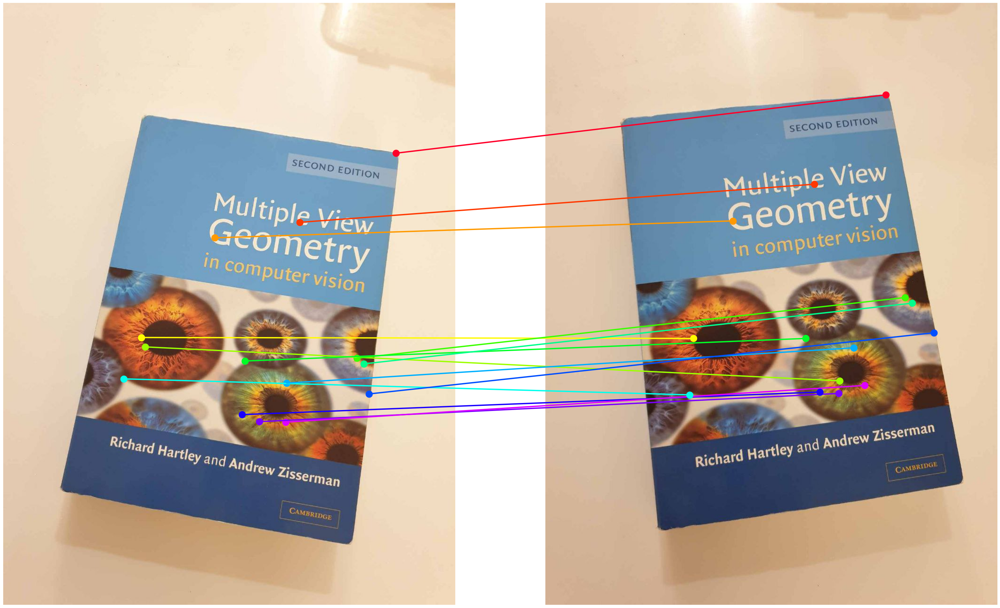

In [ ]:
plot_corresponding_points(path1, path2, points, int_points1, int_points2, "res10.jpg")

### SIFT

SIFT (Scale Invariant Feature Transform) is a computer vision algorithm that extracts the feature data from an input image. It comprises robust characteristics that prevent image transformations such as the image size and rotation in the matching of feature points. The goal of SIFT is to detect, describe, and match local features in images, which can be used for object recognition, image stitching, 3D modeling, and other applications.

The SIFT algorithm consists of four main steps:

1. Scale-space extrema detection: This step finds the potential interest points that are invariant to scale and orientation by searching for local maxima and minima of the difference-of-Gaussian function in the scale space.
2. Keypoint localization: This step eliminates the low-contrast and edge keypoints and assigns a location, scale, and orientation to each remaining keypoint based on a Taylor series expansion of the scale-space function.
3. Orientation assignment: This step assigns one or more orientations to each keypoint based on the local image gradient directions at the selected scale. This ensures that the keypoint descriptor is invariant to rotation.
4. Keypoint descriptor: This step computes a local image descriptor for each keypoint based on the image gradients in a 16x16 neighborhood around the keypoint. The descriptor is represented by a 128-dimensional vector of gradient histogram values.

The SIFT features can then be matched between different images using a nearest-neighbor approach based on the Euclidean distance of their feature vectors.


In [ ]:
def get_sift_key_points(image, color):
    sift = cv.SIFT_create()
    key_points, descriptors = sift.detectAndCompute(image, None)
    out_image = cv.drawKeypoints(image, key_points, None, color=color)
    return out_image, key_points, descriptors
def get_match_points(des1, des2, ratio_tr):
    bf = cv.BFMatcher(cv.NORM_L2, crossCheck=False)
    matches_alpha1 = bf.knnMatch(des1, des2, k=2)
    matches1 = []
    for p1, p2 in matches_alpha1:
        if p1.distance < ratio_tr * p2.distance:
            matches1.append(p1)

    matches_alpha2 = bf.knnMatch(des2, des1, k=2)
    matches2 = []
    for p1, p2 in matches_alpha2:
        if p1.distance < ratio_tr * p2.distance:
            matches2.append(p1)

    matches = []
    for m1 in matches1:
        q1 = m1.queryIdx
        t1 = m1.trainIdx
        for m2 in matches2:
            if t1 == m2.queryIdx and q1 == m2.trainIdx:
                matches.append(m1)
                break
    return matches


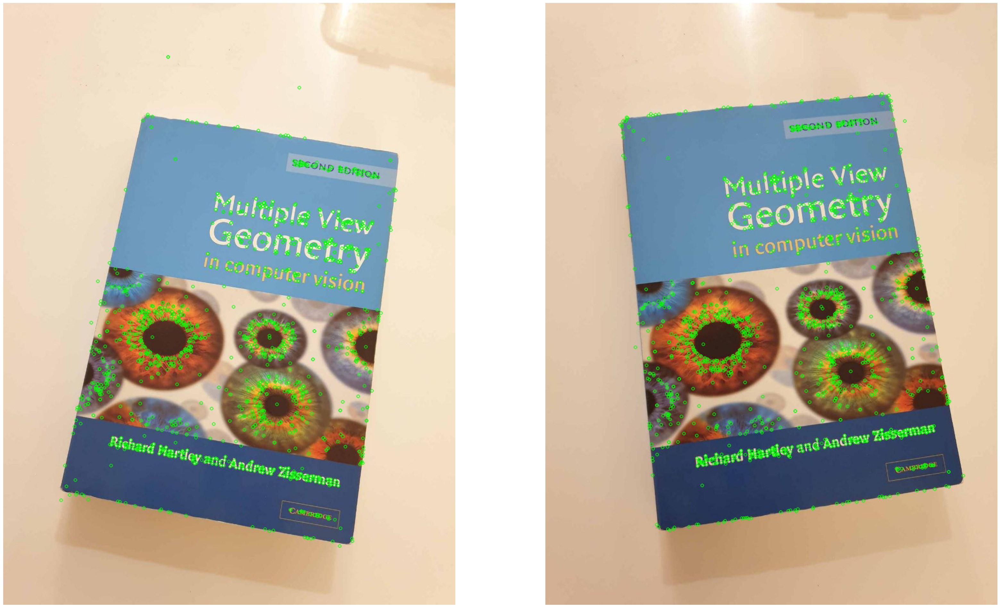

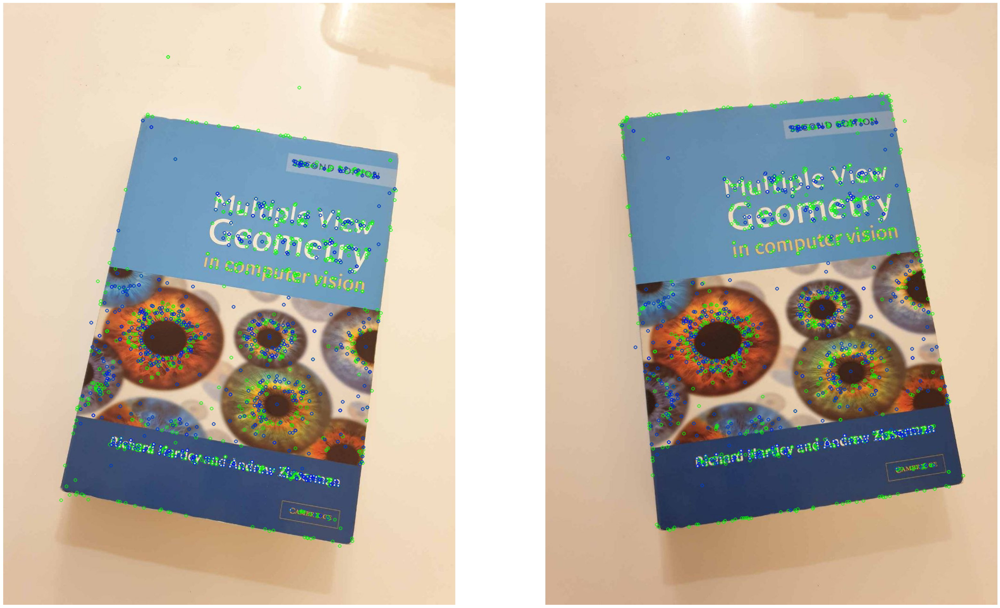

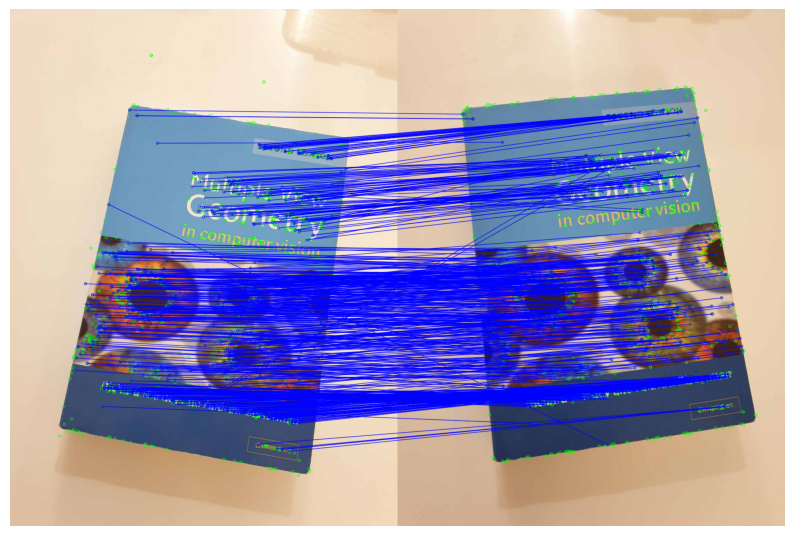

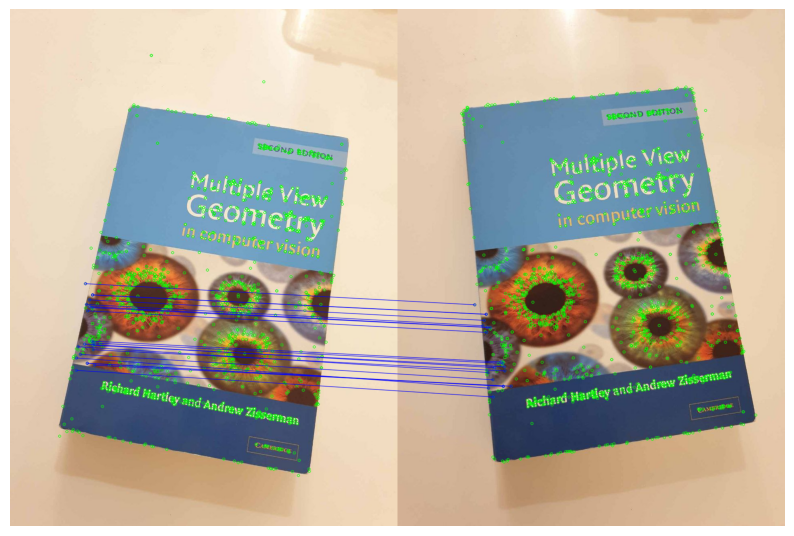

In [ ]:
img1 = get_image(path1)
img2 = get_image(path2)

red = (255, 0, 0)
green = (0, 255, 0)
blue = (0, 0, 255)

img1_with_kps, kps1, des1 = get_sift_key_points(img1, green)
img2_with_kps, kps2, des2 = get_sift_key_points(img2, green)

plot_double_arrays("test3.jpg", img1_with_kps, img2_with_kps)

ratio_tr = 0.75
matches = get_match_points(des1, des2, ratio_tr)

src_points = np.float32([kps1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
des_points = np.float32([kps2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)

img1_with_kps_and_matches = cv.drawKeypoints(img1_with_kps, [kps1[m.queryIdx] for m in matches],
                                             None, color=blue)
img2_with_kps_and_matches = cv.drawKeypoints(img2_with_kps, [kps2[m.trainIdx] for m in matches],
                                             None, color=blue)

plot_double_arrays("test4.jpg", img1_with_kps_and_matches, img2_with_kps_and_matches)

all_matched_points = cv.drawMatches(img1, kps1, img2, kps2, matches, None,
                                    matchColor=blue, singlePointColor=green)

plot_array("test5.jpg", all_matched_points)

twenty_matched_points = cv.drawMatches(img1, kps1, img2, kps2, matches[:20], None,
                                       matchColor=blue, singlePointColor=green)

plot_array("res11.jpg", twenty_matched_points)

### RANSAK

In [ ]:
def get_homography_opencv(src_points, des_points, N, x_off=1, y_off=1):
    H, status = cv.findHomography(src_points, des_points, cv.RANSAC, maxIters=N)
    offset_mat = np.array([[1, 0, x_off], [0, 1, y_off], [0, 0, 1]])
    new_H = np.matmul(offset_mat, np.linalg.inv(H))
    return new_H, H,  status
def get_inliers_and_outliers(status, matches):
    inliers = []
    outliers = []
    for i in range(len(status)):
        if status[i] == 1:
            inliers.append(matches[i])
        else:
            outliers.append(matches[i])
    return inliers, outliers


Homography matrix without offset:
[[ 1.13155951e+00  3.52582407e-01 -2.52376301e+02]
 [-2.38714994e-01  1.08025024e+00  7.03022169e+01]
 [ 1.26027910e-04  1.91974653e-05  1.00000000e+00]]
Homography matrix with offset:
[[ 4.36398463e-01 -2.06851206e-01  3.62467873e+03]
 [ 7.95228834e-02  8.82730871e-01  9.58011754e+02]
 [-1.04733215e-04  1.69033685e-05  9.72379474e-01]]
number of inliers: 581
number of outliers: 120


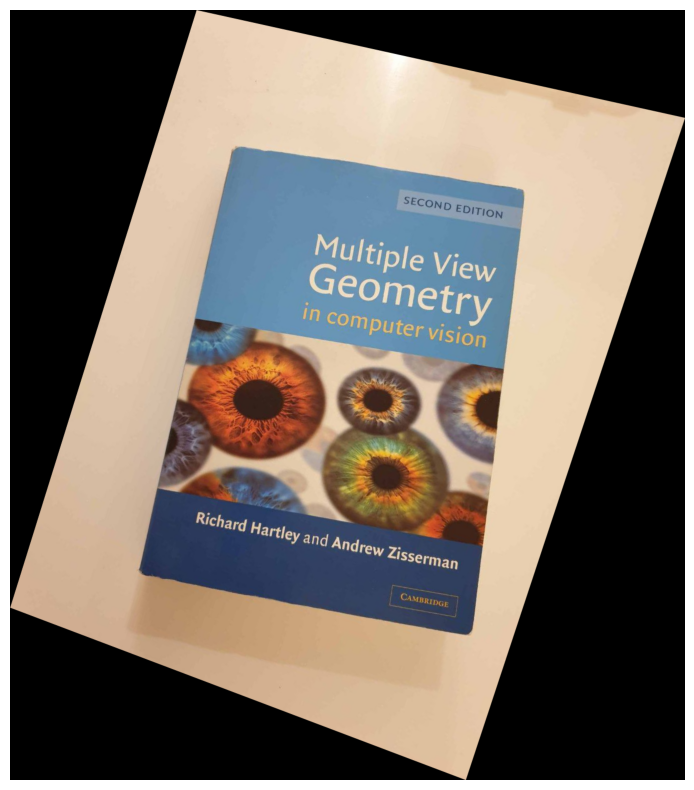

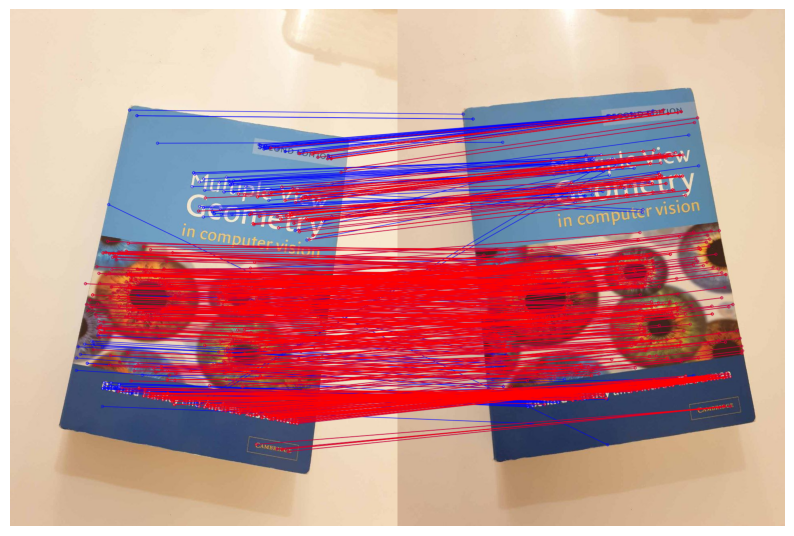

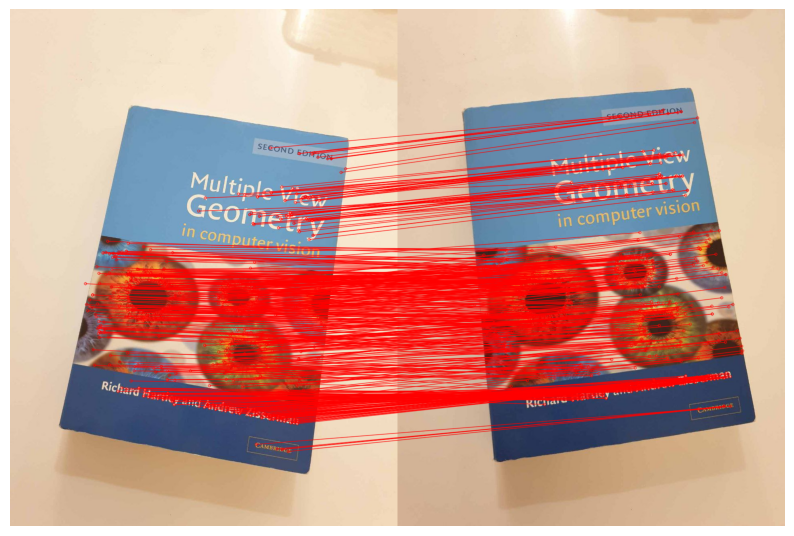

In [ ]:
x_off = 3500
y_off = 1000
N = 200

new_H, H, status = get_homography_opencv(src_points, des_points, N, x_off=x_off, y_off=y_off)
img2_after_homography = cv.warpPerspective(img2, new_H, (5*img2.shape[1], 4*img2.shape[0]))

plot_array("test6.jpg", crop_zero_parts(img2_after_homography))
inliers, outliers = get_inliers_and_outliers(status, matches)

no_single_all_matches = cv.drawMatches(img1, kps1, img2, kps2, matches, None, matchColor=blue,
                                       flags=cv.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)

flags = (cv.DrawMatchesFlags_DRAW_OVER_OUTIMG + cv.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)
no_single_all_matches_inliers = cv.drawMatches(img1, kps1, img2, kps2, inliers, no_single_all_matches.copy(),
                                               matchColor=red, flags=flags)

plot_array("test7.jpg", no_single_all_matches_inliers)

no_single_inliers = cv.drawMatches(img1, kps1, img2, kps2, inliers, None, matchColor=red,
                                   flags=cv.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)

plot_array("res12.jpg", no_single_inliers)

print("Homography matrix without offset:")
print(H)
print("Homography matrix with offset:")
print(new_H)
print("number of inliers: " + str(np.sum(status)))
print("number of outliers: " + str(int(len(status) - np.sum(status))))